# Human Activity Recognition - Logistic Regression

This notebook performs the Logistic Regression algorithm using the euclidean distance metric to classify the human activities.

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10299 entries, 0 to 10298
Columns: 563 entries, tBodyAcc-mean()-X to Activity
dtypes: float64(561), int64(1), object(1)
memory usage: 44.2+ MB
Null Values =  0


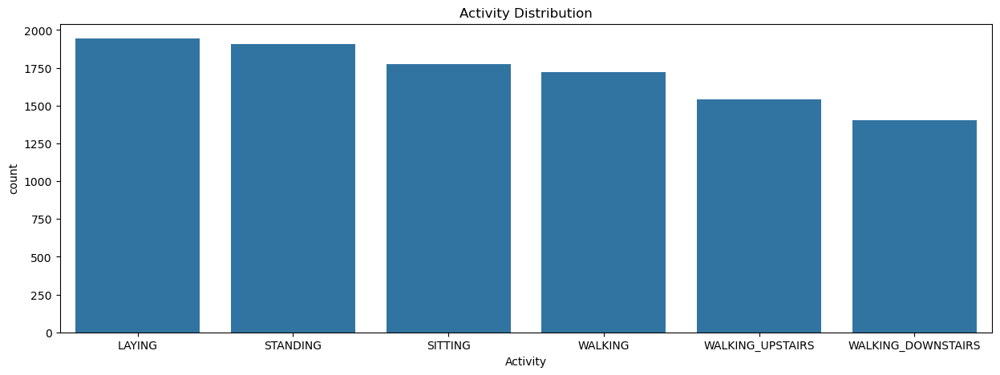

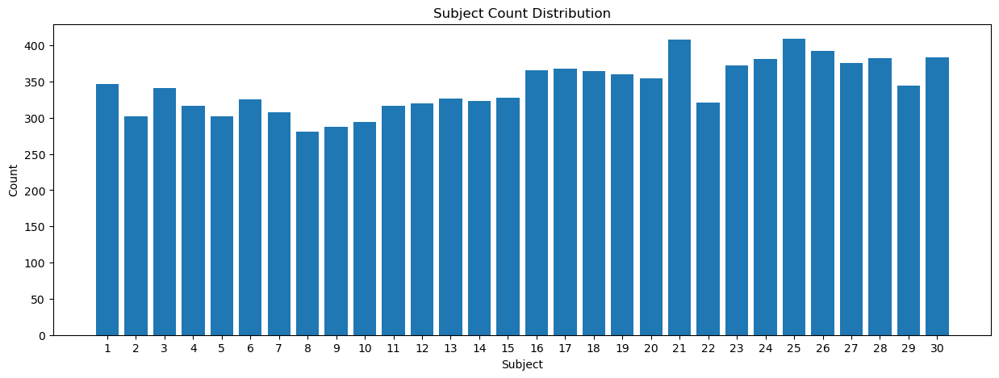

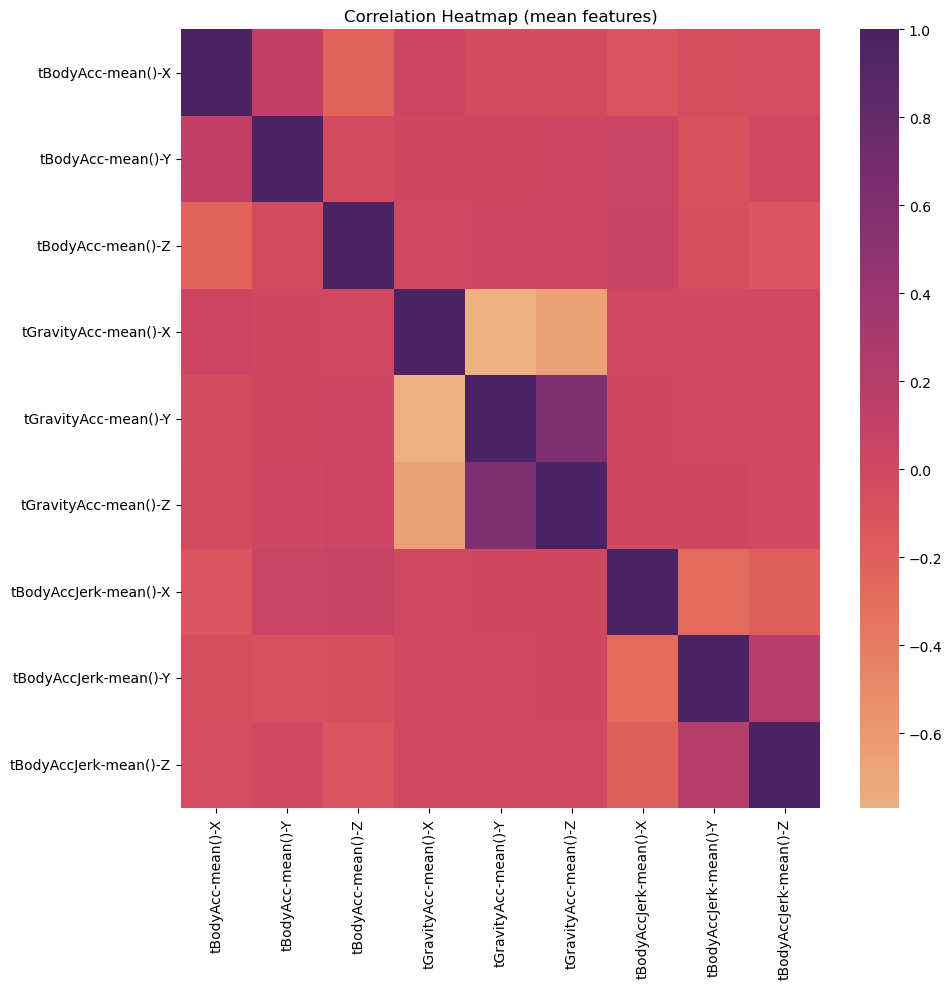

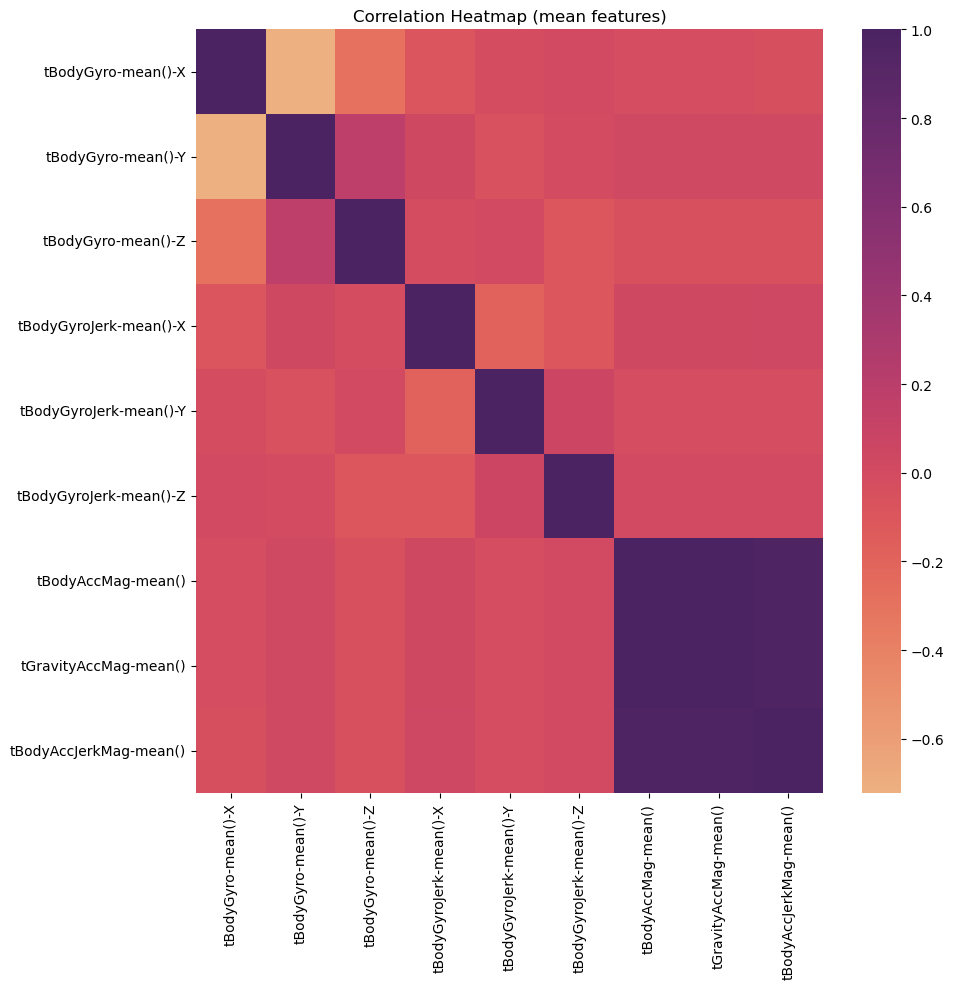

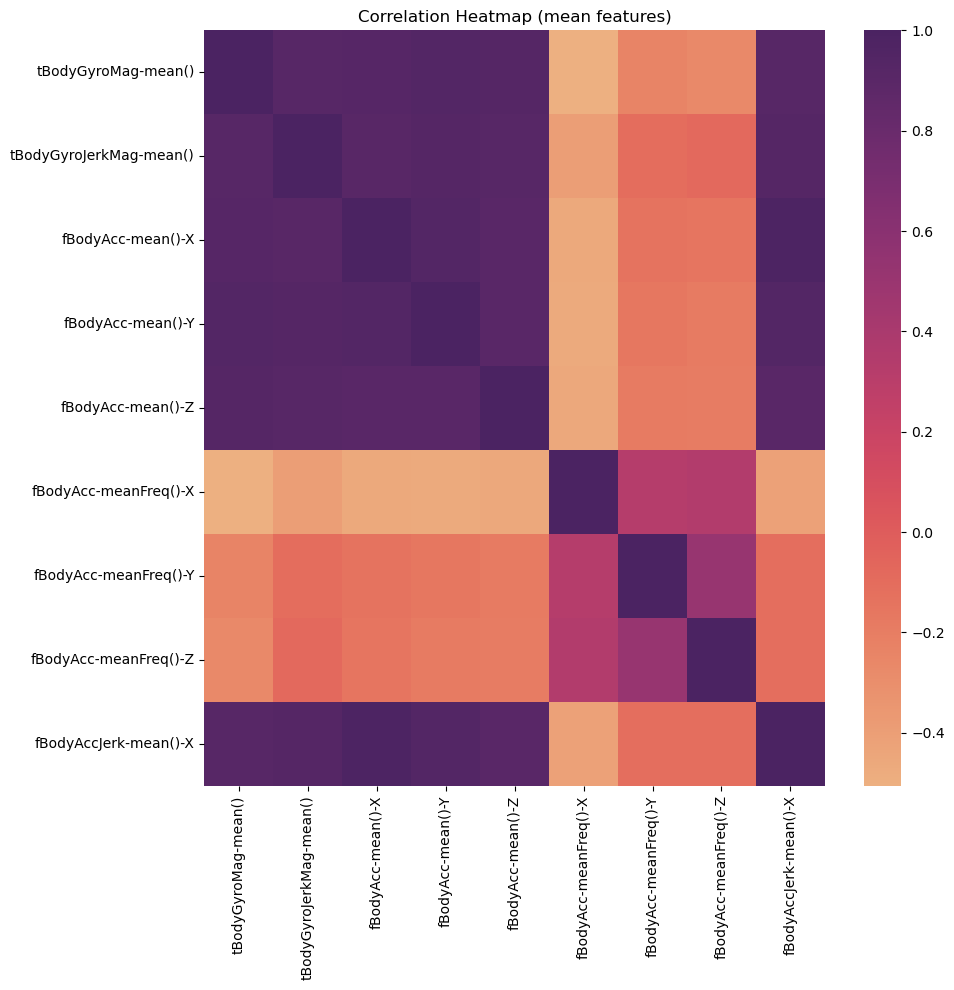

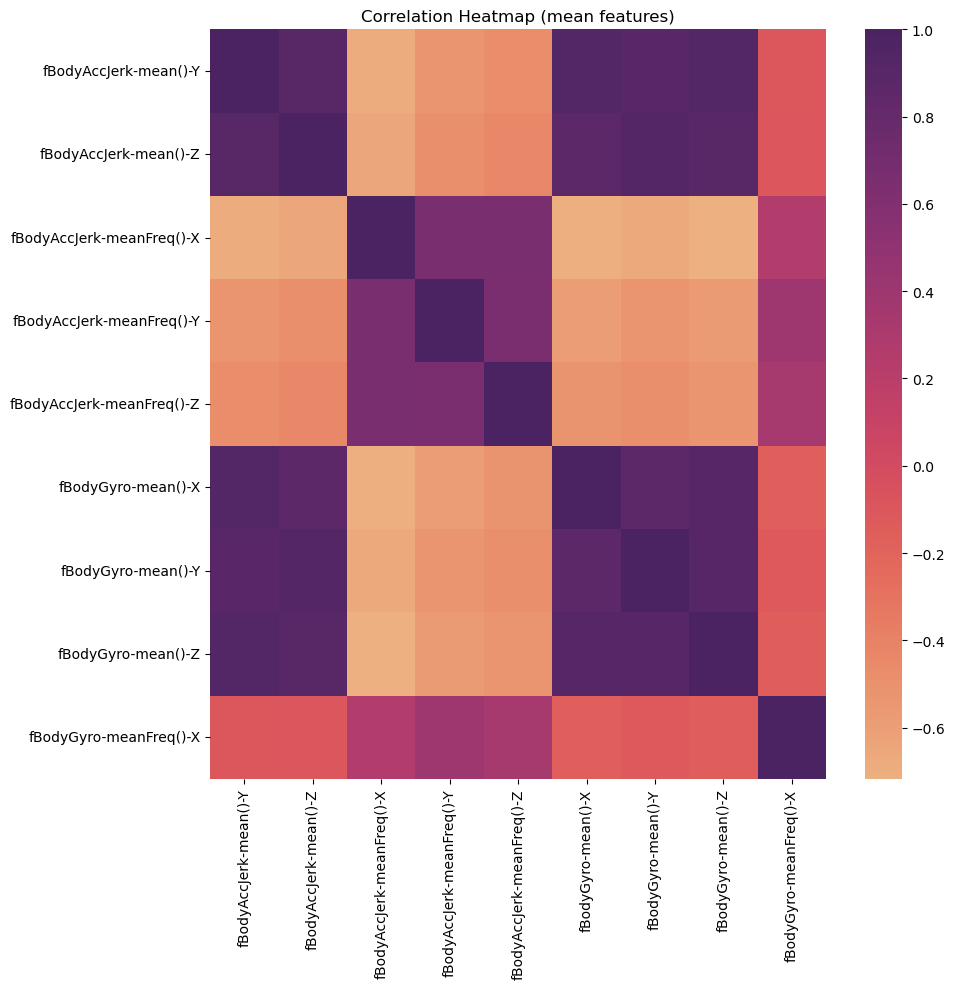

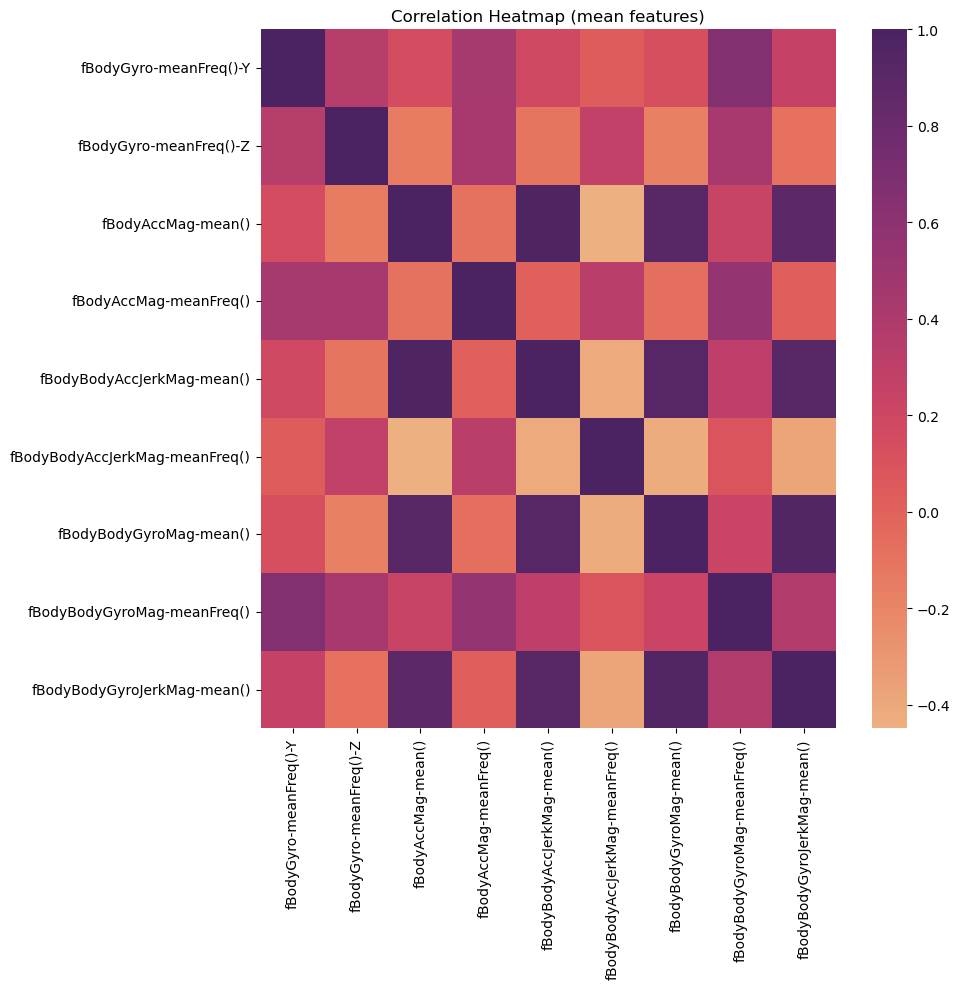

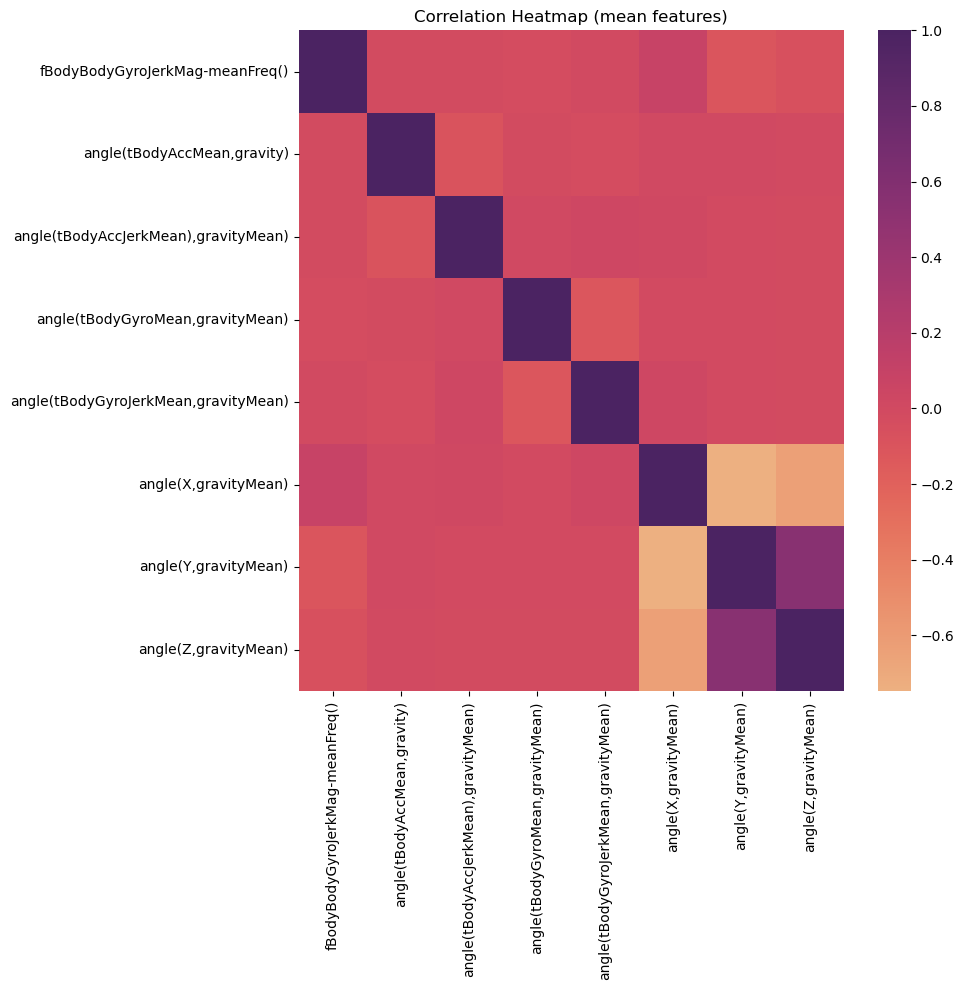

<Figure size 1000x1000 with 0 Axes>

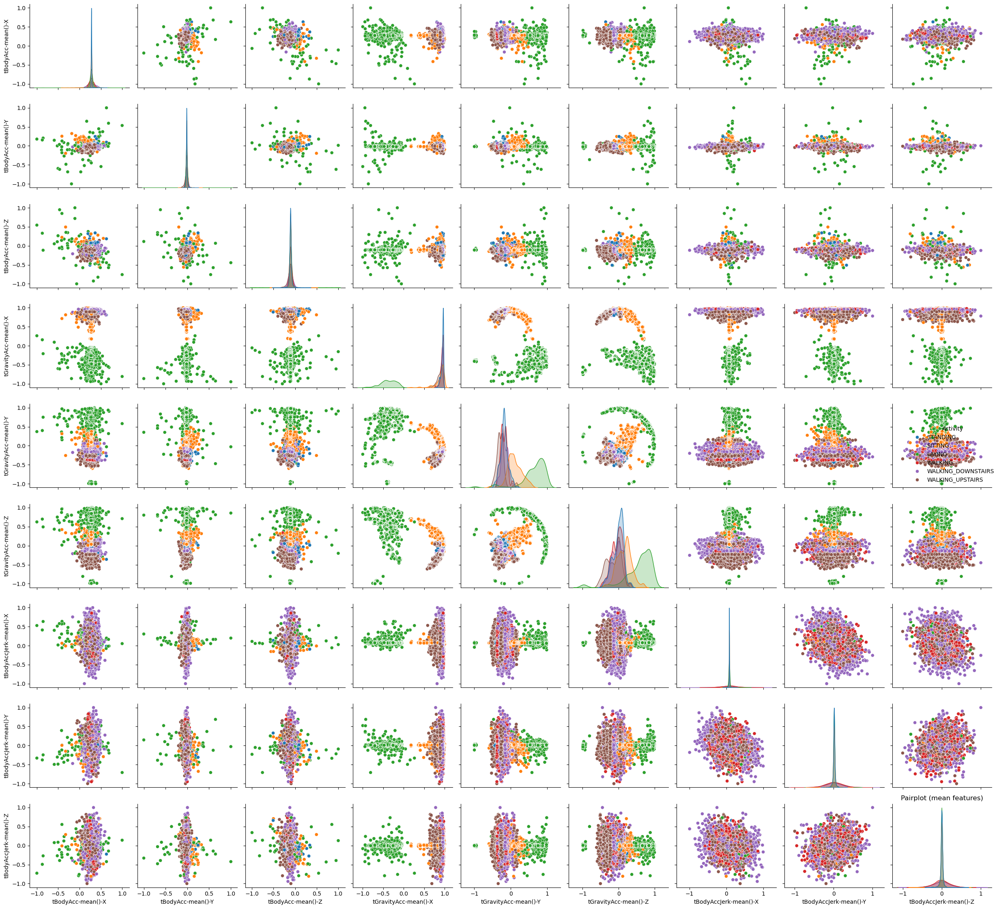

<Figure size 1000x1000 with 0 Axes>

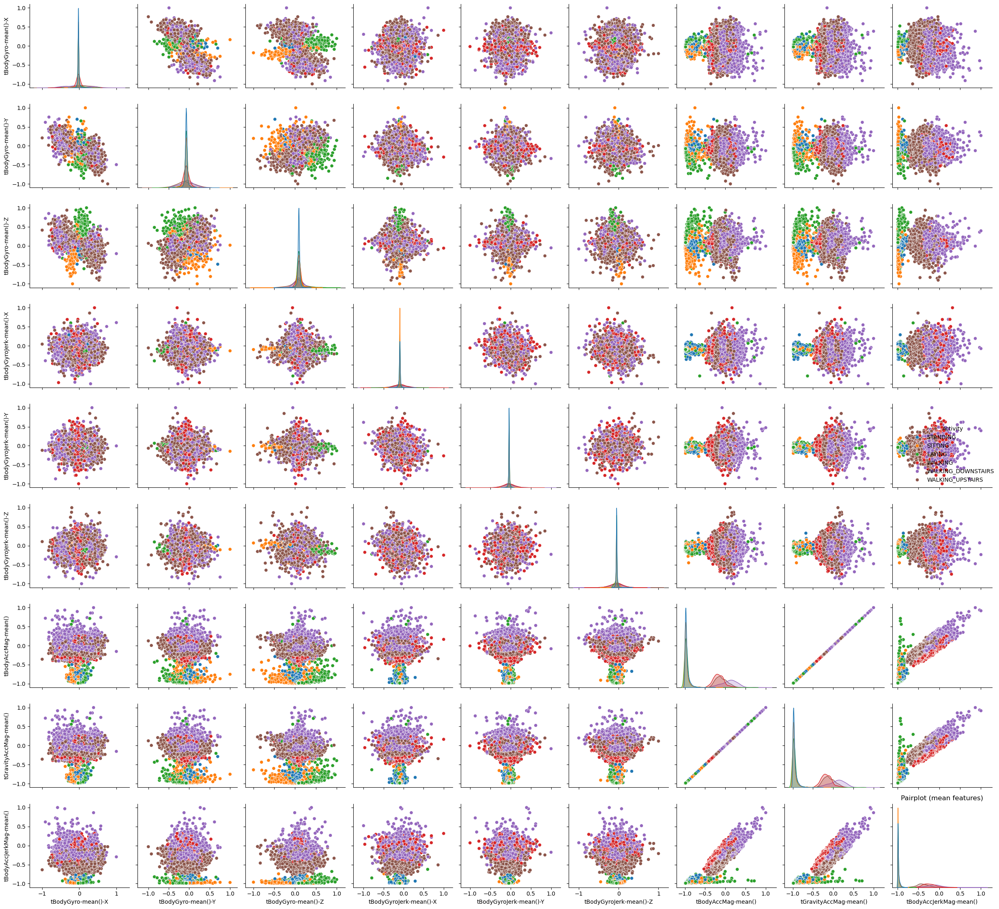

<Figure size 1000x1000 with 0 Axes>

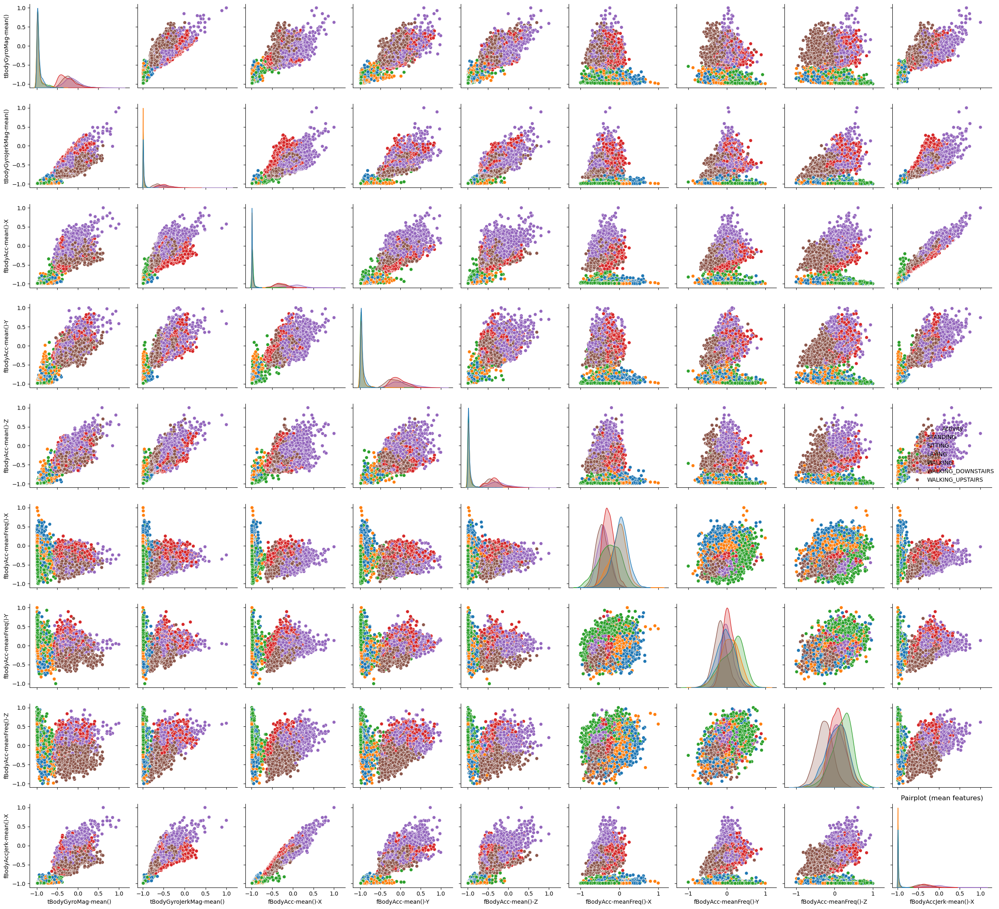

<Figure size 1000x1000 with 0 Axes>

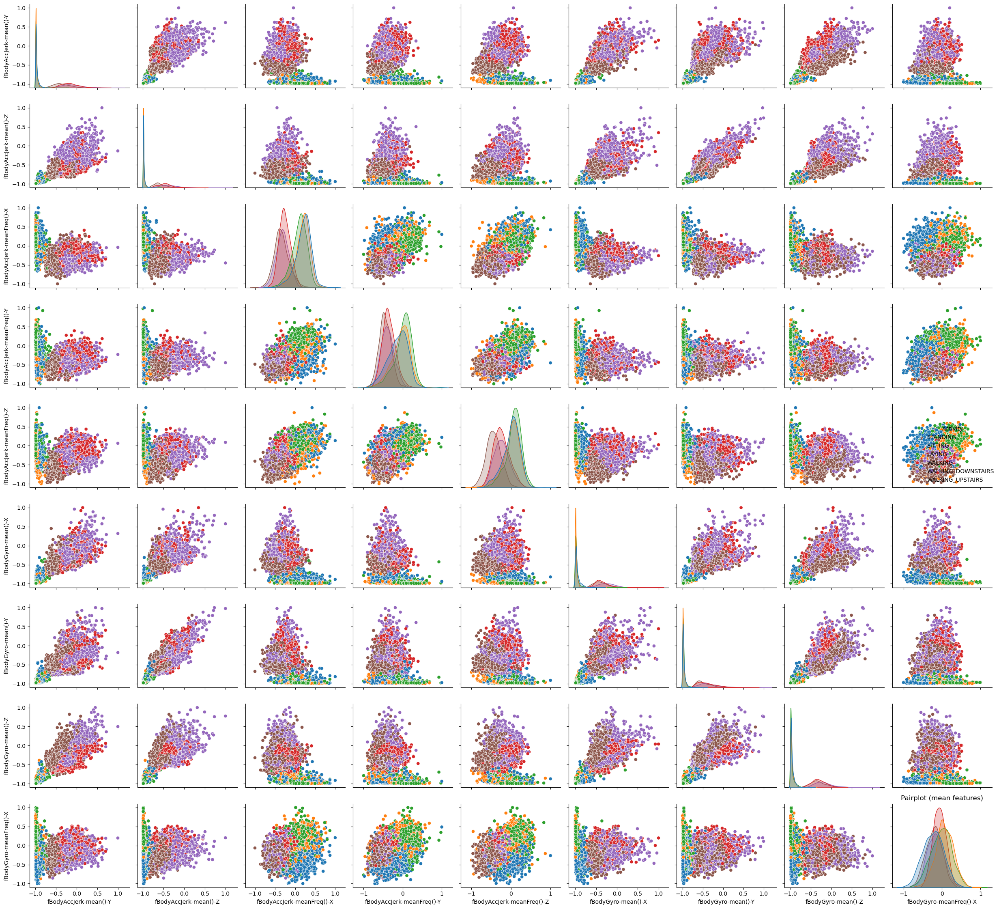

<Figure size 1000x1000 with 0 Axes>

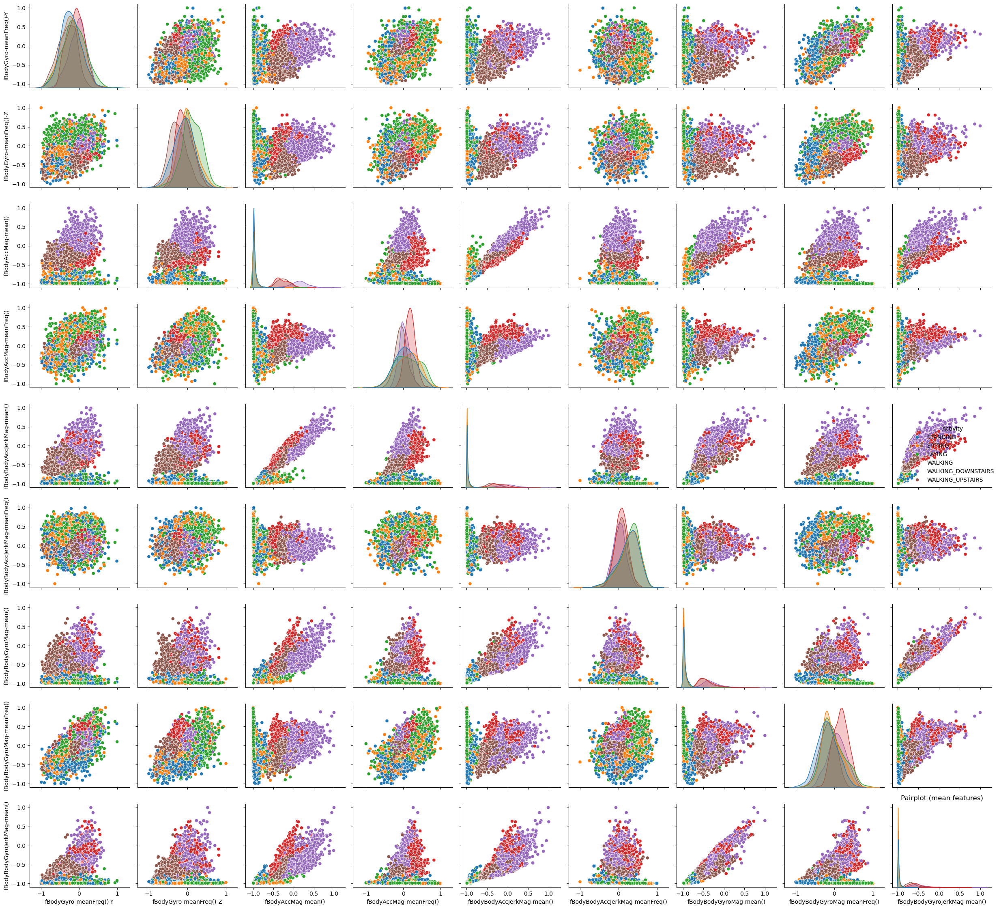

<Figure size 1000x1000 with 0 Axes>

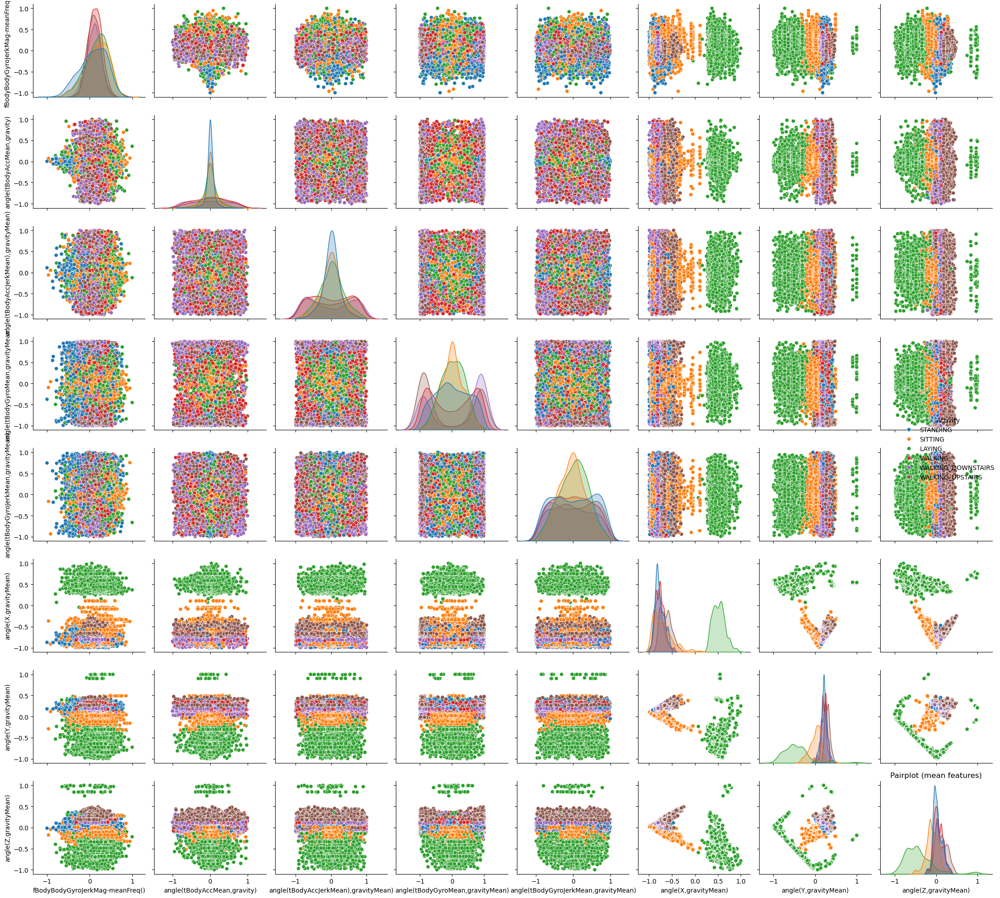

In [2]:
from typing import List, Dict, Tuple, Callable
import os
import gc
import traceback
import warnings
from pdb import set_trace

import sklearn
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

np.set_printoptions(suppress=True)

%run EDA_Preprocessing.ipynb

## Metrics

In [4]:
from sklearn.metrics import (
    accuracy_score,
    confusion_matrix
)

## Plots

In [6]:
def plot_decision_boundary(
    softreg: object, 
    X: np.ndarray, 
    y: np.ndarray,
    xlabel: str = '',
    ylabel: str = '',
    class_names: Dict = None
) -> None:
    """ Plots the decision boundry for data with 2 features. 
    
        Warning: 
            If you have more than 2 features (2D data) the decision boundry
            can not be plotted.
    
        Args:
            softreg: An instance of SoftmaxRegression class
            
            X: Data to be plotted

            y: Labels for corresponding data

            xlabel: X-axis label for plot

            ylabel: Y-axis label for plot
            
            class_names: Dictionary mapping labels to class names.
    """
    assert X.shape[-1] == 2, f"`X` must have 2 features not {X.shape[-1]}"
        
    if class_names is None:
        class_names = {}

    # Generate fake data to cover entire space of our input features X
    buffer = .5
    x_min, x_max = X[:, 0].min() - buffer, X[:, 0].max() + buffer
    y_min, y_max = X[:, 1].min() - buffer, X[:, 1].max() + buffer
    xx, yy = np.meshgrid(np.arange(x_min, x_max, .02),
                         np.arange(y_min, y_max, .02))
    fake_data = np.c_[xx.ravel(), yy.ravel()].reshape(-1,2)
    fake_data =  np.hstack([np.ones((len(fake_data), 1)), fake_data])
    # Make prediction
    y_hat = softreg.predict(fake_data)

    # Plot
    plt.contourf(xx, yy, y_hat.reshape(xx.shape))
    
    labels = np.unique(y)
    for l in labels:
        class_locs = np.where(y == l)[0]
        class_name = class_names.get(l, f'class {l}')
        plt.scatter(X[class_locs, 0], X[class_locs, 1], label=class_name)

    plt.xlim(xx.min(), xx.max())
    plt.ylim(yy.min(), yy.max())
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.legend()
    plt.show()

In [7]:
def plot_confusion_matrix(
    y: np.ndarray, 
    y_hat: np.ndarray, 
    class_names: Dict[int, str] = None,
    figsize: Tuple = (10, 5)
) -> pd.DataFrame:
    """ Plots a pretty and labeld version of Sklerarn's confusion matrix

        Args:
            y: Ground truth labels given as a 1D vector

            y_hat: Predicted labels given as a 1D vector

            class_names: Dictionary mapping labels to class names.

                Example: {0: 'setosa', 1: 'versicolor', 2: 'virginica'}

            figsize: A tuple for setting the width and height of the plot.

        Returns:
            A confusion matrix casted as a DataFrame
    """
    y =  y.flatten() # reshape to make 1D vector for consistency
    y_hat = y_hat.flatten() # reshape to make 1D vector for consistency
    
    cfm = confusion_matrix(y_true=y, y_pred=y_hat)    
    
    labels = np.sort(np.unique(y))
    if class_names is not None:
        classes = []
        for l in labels:
            class_name = class_names.get(l, l)
            classes.append(class_name)
        labels = classes
        
    columns, index = labels, labels
    fig, ax = plt.subplots(figsize=figsize)  
    cfm_df = pd.DataFrame(cfm, index=index, columns=columns)
    sns.heatmap(cfm_df, annot=True, fmt='g', ax=ax)
    plt.show()
    return cfm_df

## Activation Functions

In [9]:
def sigmoid(z: np.ndarray) -> np.ndarray:
    y_values = np.exp(z) / (1 + np.exp(z))
    return y_values

In [10]:
def softmax(z: np.ndarray) -> np.ndarray:
    """ Computes the stablized version of the softmax

        Args:
            z: A vector or matrix of continuous values.

        Returns:
            A NumPy array with the same shape as the input.
    """
    z_max = np.max(z, axis = 1, keepdims = True)
    probs = np.exp(z - z_max) / np.sum(np.exp(z - z_max), axis = 1, keepdims = True)   ##Numpy.sum
    return probs

## Negative Log Likelihood (NLL)

In [12]:
def nll_loss(y: np.ndarray, probs: np.ndarray) -> float:
    """ Computes the average generalized NLL Loss

        Args:
            y: The ground truth one-hot encoded labels
                given as matrix of shape (N, K).

            probs: The predicted probabilities for the
                corresponding labels given as a matrix
                of shape (N, K)
        Returns:
            A NLL loss given as a float.
    """
    avg_loss = -np.mean(np.log(np.sum(y * probs, axis=1)))
    return avg_loss

## Softmax Regression

In [14]:
def get_batches(
    data_len: int, 
    batch_size: int = 32,
) -> List[np.ndarray]:
    """ Generates mini-batches based on the data indexes
        
        Args:
            data_len: Length of the data or number of data samples 
                in the data. This is used to generate the indices of
                the data.
            
            batch_size: Size of each mini-batch where the last mini-batch
                might be smaller than the rest if the batch_size does not 
                evenly divide the data length.

        Returns:
            A list of NumPy array's holding the indices of batches
    """
    indices = np.arange(data_len)
    np.random.shuffle(indices)
    batches = [indices[i:i+batch_size] for i in range(0, data_len, batch_size)]

    return batches

In [15]:
class SoftmaxRegression():
    """ Performs softmax regression using gradient descent
    
        Attributes:

            alpha: learning rate or step size.
                
            batch_size: Size of mini-batches for mini-batch gradient
                descent.
            
            epochs: Number of epochs to run for mini-batch
                gradient descent.
                
            seed: Seed to be used for NumPy's RandomState class
                or universal seed np.random.seed() function.

            W: Matrix of weights with shape (M, K) 

            trn_loss: Stores the training loss for each epoch.

            vld_loss: Stores the validation loss for each epoch.
    """
    def __init__(
        self, 
        alpha: float,
        batch_size: int,
        epochs: int = 1,
        seed: int = 0,
    ):

        self.alpha = alpha
        self.batch_size = batch_size
        self.epochs = epochs
        self.seed = seed
        
        self.W = None
        self.trn_loss = None
        self.vld_loss = None
    
    def fit(
         self, 
         X: np.ndarray, 
         y: np.ndarray, 
         X_vld: np.ndarray=None, 
         y_vld: np.ndarray=None
     ) -> object:
        """ Trains softmax regressio using SGD
        
            Args:
                X: Training data given as a 2D matrix

                y: Training labels given as a 2D column vector

                X_vld: Validation data given as a 2D matrix. Used 
                    to compute the validation accuracy for each epoch.

                y_vld: Validation labels given as a 2D matrix. Used 
                    to compute the validation accuracy for each epoch.
                
            Returns:
                The class's own object reference. 
        """
        # Set seed for reproducibility
        np.random.seed(self.seed)
        # Track training/validation loss
        self.trn_loss = []
        self.vld_loss = []

        M = X.shape[1]
        K = y.shape[1]
        self.W = np.random.rand(M, K)
        for e in range(self.epochs):
            batches = get_batches(X.shape[0], self.batch_size)
            for b in batches:
                X_b, y_b = X[b], y[b]
                Z = X_b @ self.W
                Y_hatprobs = softmax(Z)
                self.W -= self.alpha * (1/X_b.shape[0] * (X_b.T @ (Y_hatprobs - y_b)))
                
            trn_probs = softmax(X @ self.W)
            trn_loss = nll_loss(y, trn_probs)
            self.trn_loss.append(trn_loss)
            
            if X_vld is not None and y_vld is not None:
                vld_probs = softmax(X_vld @ self.W)
                vld_loss = nll_loss(y_vld, vld_probs)
                self.vld_loss.append(vld_loss)

        return self
        
    def predict(self, X: np.ndarray) -> np.ndarray:
        """ Make predictions using learned weights

            Args:
                X: Testing data given as a 2D matrix

            Returns:
                A 2D column vector of predictions for each data sample in X
        """
        y_hat = np.argmax(softmax(X @ self.W), axis=1)   ##Numpy.argmax
        return y_hat

## Training

Training accuracy: 0.9921104536489151


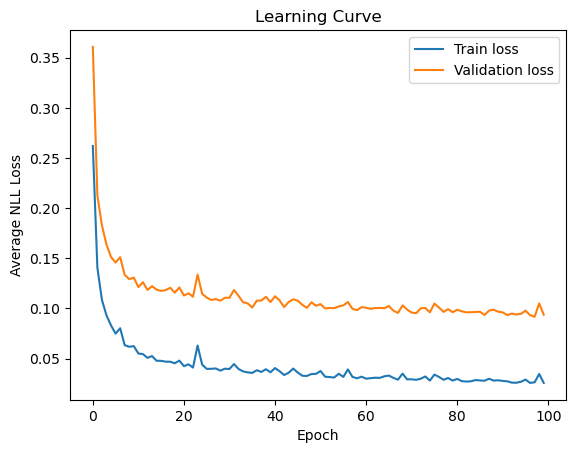

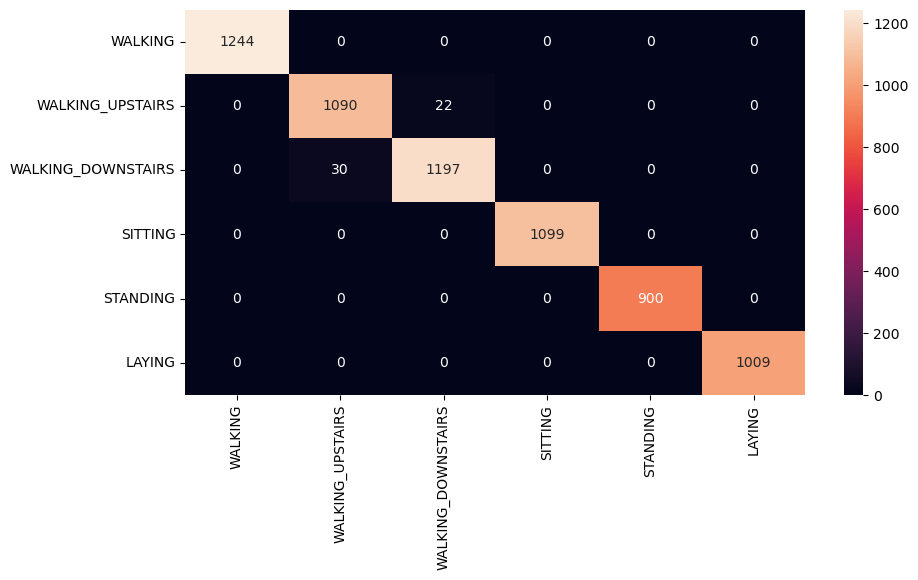

In [17]:
label2name = {
    0: 'WALKING',
    1: 'WALKING_UPSTAIRS',
    2: 'WALKING_DOWNSTAIRS',
    3: 'SITTING',
    4: 'STANDING',
    5: 'LAYING'
}

X_trn, y_trn, X_vld, y_vld, X_tst, y_tst = get_preprocessed_logreg_data()

softreg = SoftmaxRegression(alpha = 0.1, batch_size = 64, epochs = 100, seed = 42)
softreg.fit(X_trn, y_trn, X_vld = X_vld, y_vld = y_vld)

y_hat_trn = softreg.predict(X_trn)
y_trn_labels = np.argmax(y_trn, axis=1)
train_accuracy = accuracy_score(y_trn_labels, y_hat_trn)
print("Training accuracy:", train_accuracy)

plt.plot(softreg.trn_loss, label='Train loss')
plt.plot(softreg.vld_loss, label='Validation loss')
plt.title("Learning Curve")
plt.ylabel("Average NLL Loss")
plt.xlabel("Epoch")
plt.legend()
plt.show()

cfm = plot_confusion_matrix(y_trn_labels, y_hat_trn, class_names = label2name)

## Validation

Validation accuracy: 0.9745145631067961


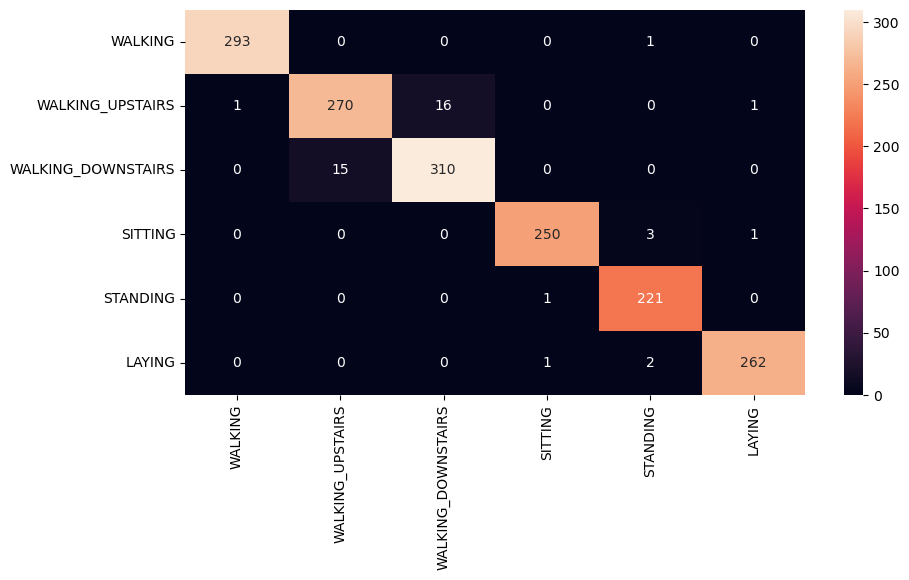

In [19]:
y_hat_vld = softreg.predict(X_vld)
y_vld_labels = np.argmax(y_vld, axis=1)
valid_accuracy = accuracy_score(y_vld_labels, y_hat_vld)
print("Validation accuracy:", valid_accuracy)

cfm = plot_confusion_matrix(y_vld_labels, y_hat_vld, class_names = label2name)

## Testing

Testing accuracy: 0.9766990291262136


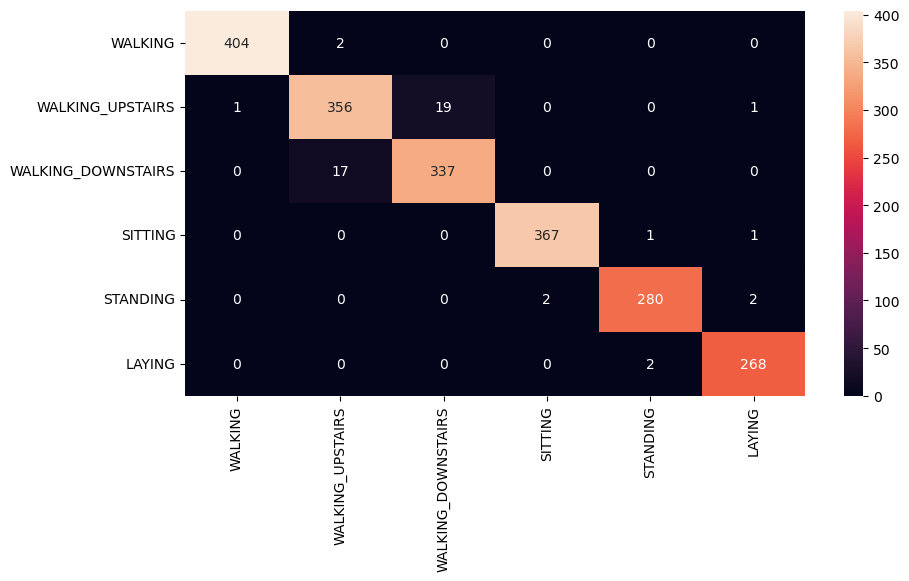

In [21]:
y_hat_tst = softreg.predict(X_tst)
y_tst_labels = np.argmax(y_tst, axis=1)
test_accuracy = accuracy_score(y_tst_labels, y_hat_tst)
print("Testing accuracy:", test_accuracy)

cfm = plot_confusion_matrix(y_tst_labels, y_hat_tst, class_names = label2name)